In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# lazy 
from lazypredict.Supervised import LazyClassifier
from sklearn.utils import all_estimators
from sklearn.base import ClassifierMixin

# search hyperparameters
from sklearn.model_selection import train_test_split, KFold, GridSearchCV, RandomizedSearchCV
from skopt import BayesSearchCV

# modèles 
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier 
from sklearn.tree import DecisionTreeClassifier
from imblearn.ensemble import BalancedRandomForestClassifier, BalancedBaggingClassifier

import xgboost as xgb
import shap

# métriques 
from imblearn.metrics import classification_report_imbalanced, geometric_mean_score
from sklearn.metrics import classification_report,accuracy_score, f1_score, fbeta_score
from sklearn.metrics import make_scorer, confusion_matrix, precision_score, recall_score, precision_recall_curve

# Rééchantillonage
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek

from imblearn.under_sampling import RandomUnderSampler

# scaling
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler

# sauvegarde model
import pickle
import itertools
import os

# import des fonctions de modélisations
import  modeling_functions as mf
import os

# Graph de résultat par modèle

Part des données par années  Date
2008   0.05
2009   0.17
2010   0.29
2011   0.39
2012   0.50
2013   0.60
2014   0.71
2015   0.83
2016   0.94
2017   1.00
Name: count, dtype: float64
Séparation des données avant et après  2015
Fitting  RandomForestClassifier


Nom du modèle : RandomForestClassifier
Rapport de classification :
              precision  recall  f1-score  support
0.0                0.88    0.98      0.92   708.00
1.0                0.86    0.48      0.62   191.00
accuracy           0.87    0.87      0.87     0.87
macro avg          0.87    0.73      0.77   899.00
weighted avg       0.87    0.87      0.86   899.00
Matrice de confusion :
      0.00  1.00
0.00   693    15
1.00    99    92


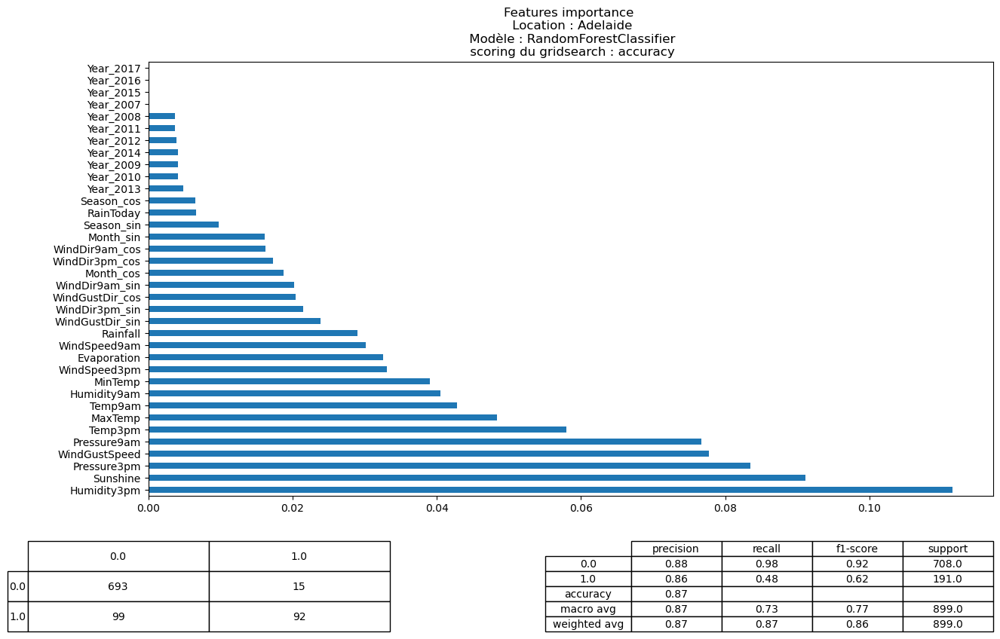

In [2]:
# Test sur une location

# model par location
select_location = "Adelaide"

# Choix des modèles (fixe pour l'instant) 
models_select  = {
    'LogisticRegression': LogisticRegression(max_iter = 500, n_jobs=-1),
    'RandomForestClassifier': RandomForestClassifier(n_jobs=-1),
    'BalancedRandomForestClassifier': BalancedRandomForestClassifier(n_jobs=-1)
}

df_location =  pd.read_csv("../src/data_location_V2/df_" + select_location + ".csv", index_col=["id_Location","id_Date"])
X_train, X_test, y_train, y_test = \
        mf.separation_train_test(df_location, 
                            sep_method = "temporelle", 
                            col_target = "RainTomorrow")


X_train_scaled, X_test_scaled = mf.scaling(X_train, X_test, scaler = MinMaxScaler())


modeling_batch = "simplegrid"
scoring = "accuracy"
dataset = "V3t"
model_name = "RandomForestClassifier"
model_qual = "best"
variable_cible = "RainTomorrow"

model_dir =  "../saved_models/location/" + dataset + "/" + modeling_batch + "/" + \
    scoring + "_"+ select_location + "_" + model_qual + "_" + model_name

graph_dir = "../modeling_results/location/" + dataset + "/" + modeling_batch + "/" + \
    scoring + "_" + select_location + "_" + model_qual + "_" + model_name

graph_title = "\n Location : " + select_location +\
        "\n Modèle : " + model_name +\
        "\n scoring du gridsearch : " + scoring
        
n_coef_graph = 40

mf.plot_model_results(model_name, model_dir, graph_dir, 
                      graph_title,
                      X_train_scaled, X_test_scaled, y_train, y_test,
                      n_coef_graph)

# Génération des graphes sur toutes les locations pour un jeu de données

Part des données par années  Date
2008   0.05
2009   0.18
2010   0.30
2011   0.40
2012   0.51
2013   0.59
2014   0.70
2015   0.82
2016   0.95
2017   1.00
Name: count, dtype: float64
Séparation des données avant et après  2015
Fitting  LogisticRegression


Nom du modèle : LogisticRegression
Rapport de classification :
              precision  recall  f1-score  support
0.0                0.87    0.98      0.92   596.00
1.0                0.87    0.52      0.65   180.00
accuracy           0.87    0.87      0.87     0.87
macro avg          0.87    0.75      0.78   776.00
weighted avg       0.87    0.87      0.86   776.00
Matrice de confusion :
      0.00  1.00
0.00   582    14
1.00    87    93
Part des données par années  Date
2008   0.01
2009   0.15
2010   0.29
2011   0.43
2012   0.56
2013   0.70
2014   0.84
2015   0.92
2016   0.99
2017   1.00
Name: count, dtype: float64
Séparation des données avant et après  2014
Fitting  LogisticRegression


Nom du modèle : LogisticRegression
Rapport de

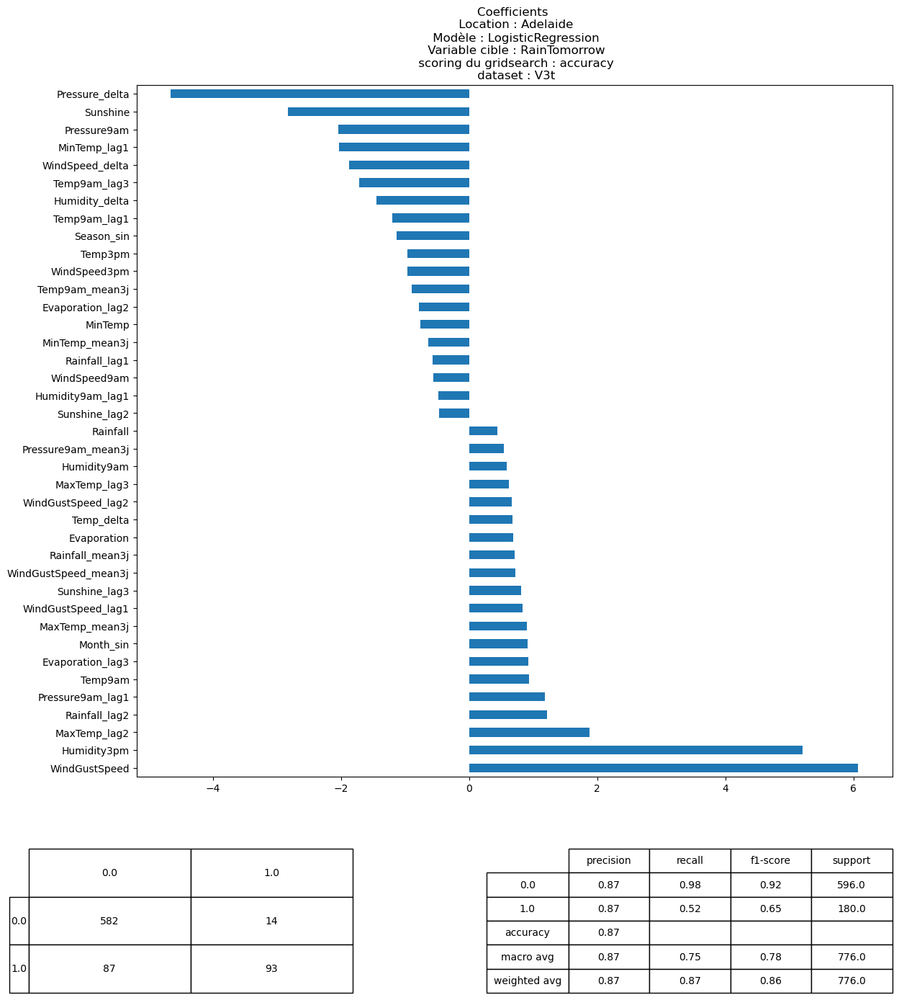

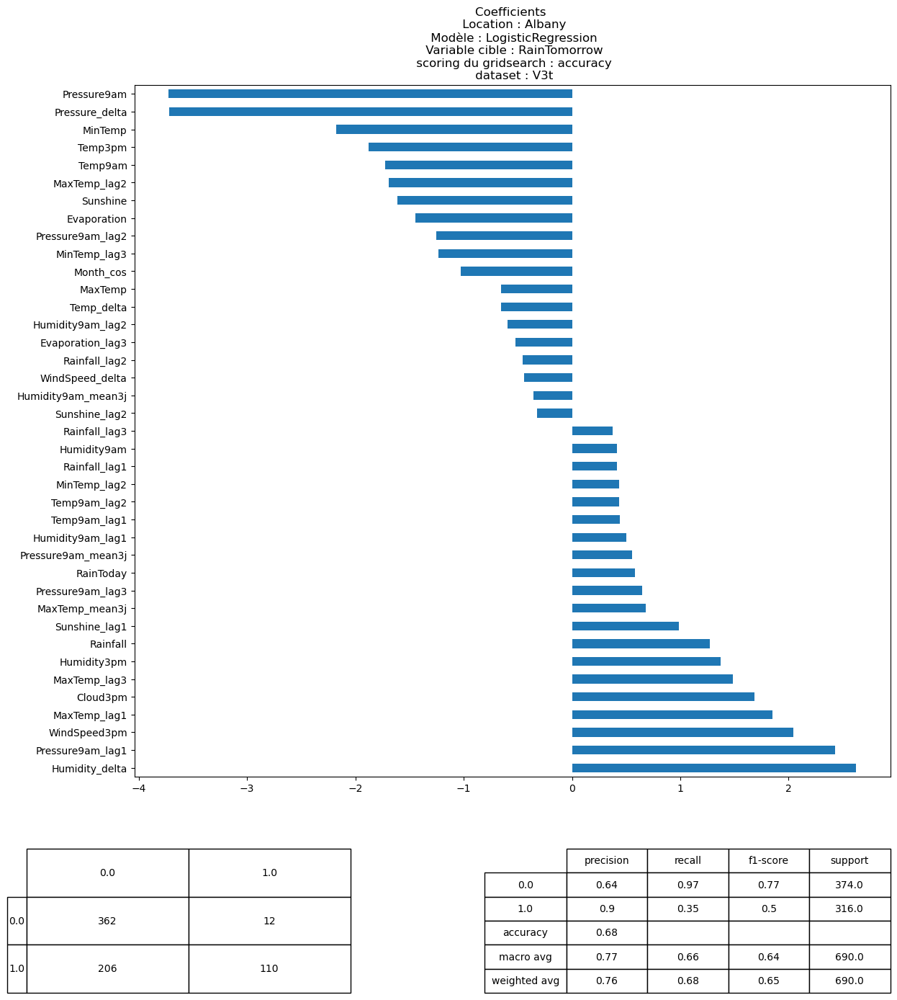

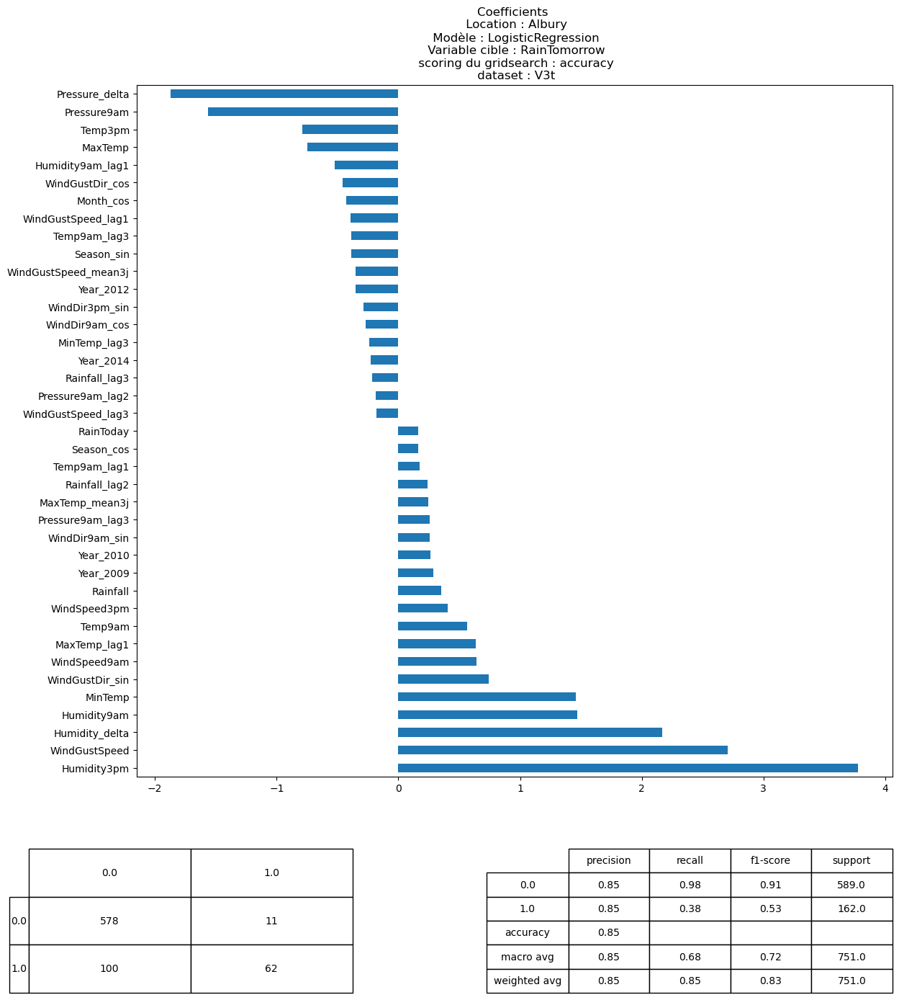

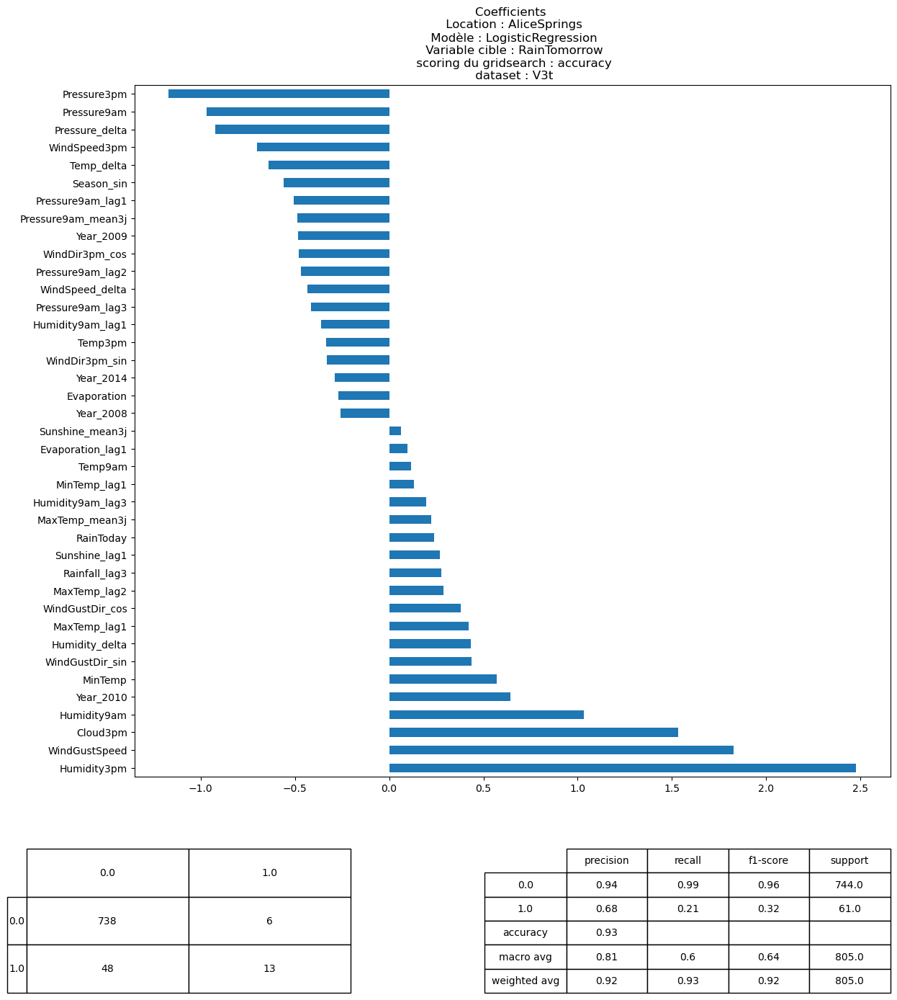

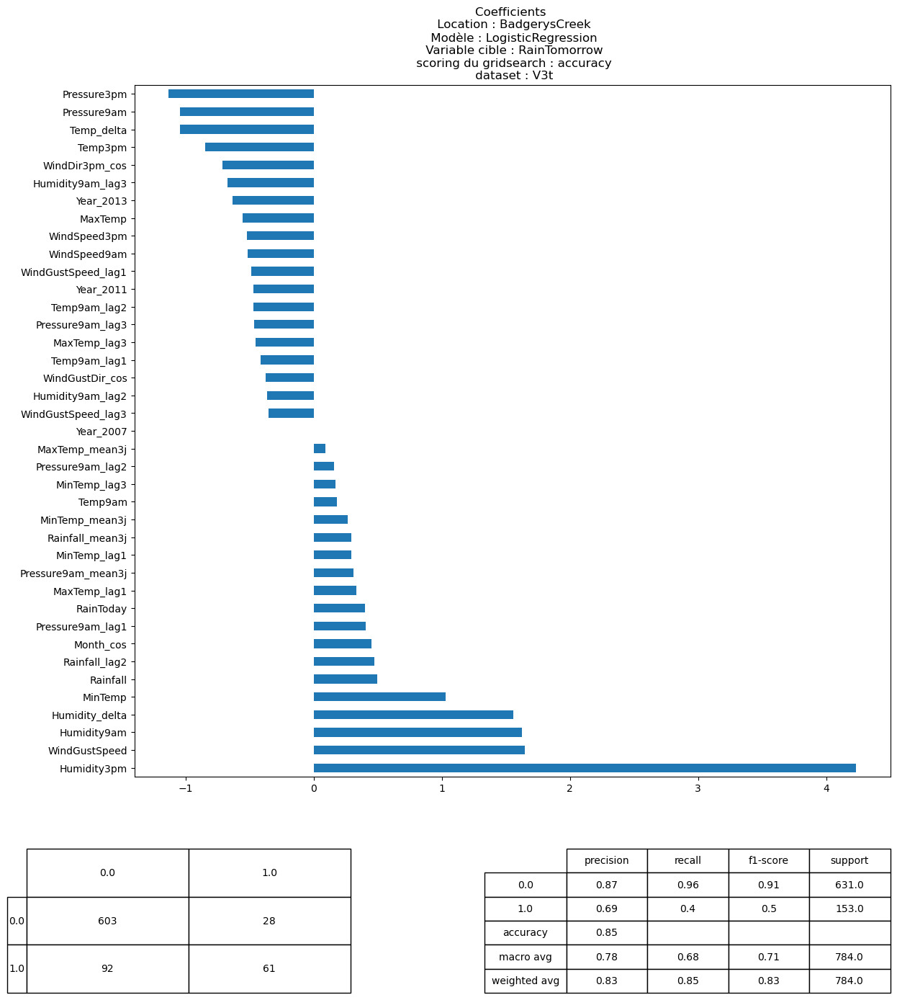

...

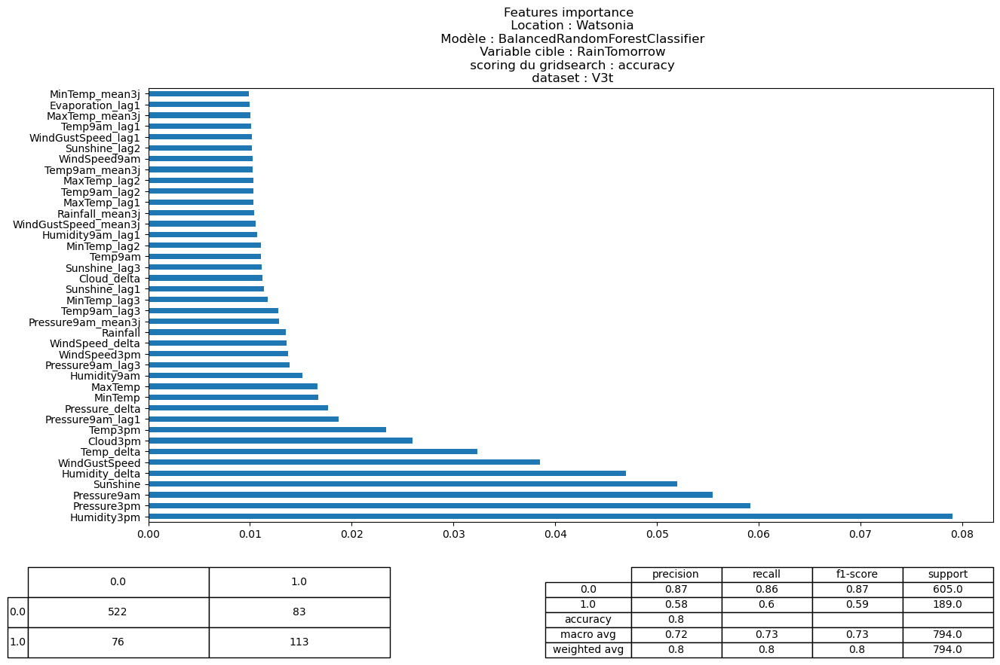

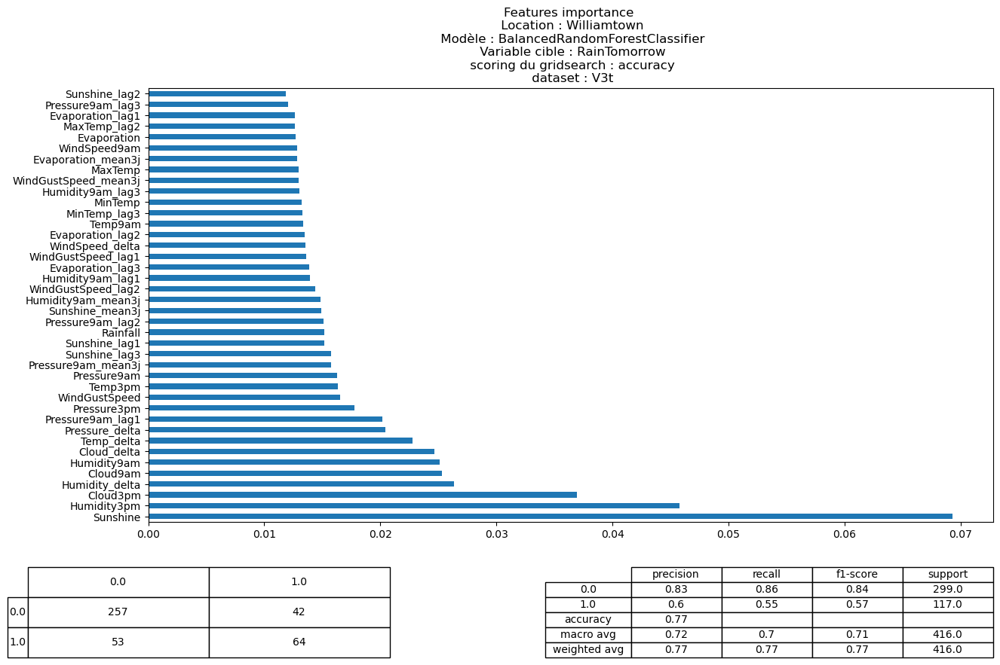

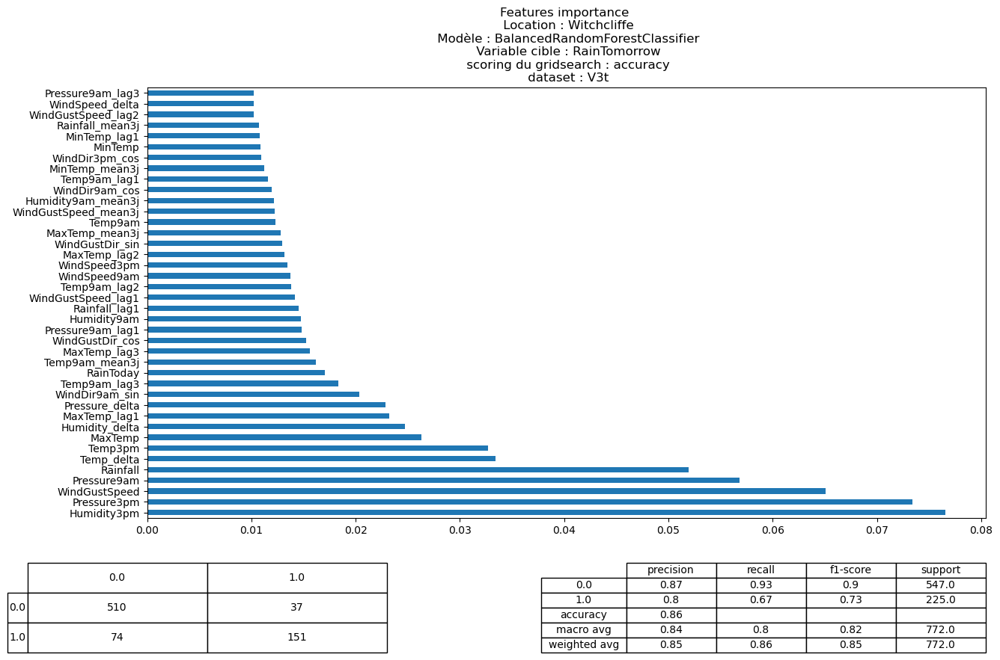

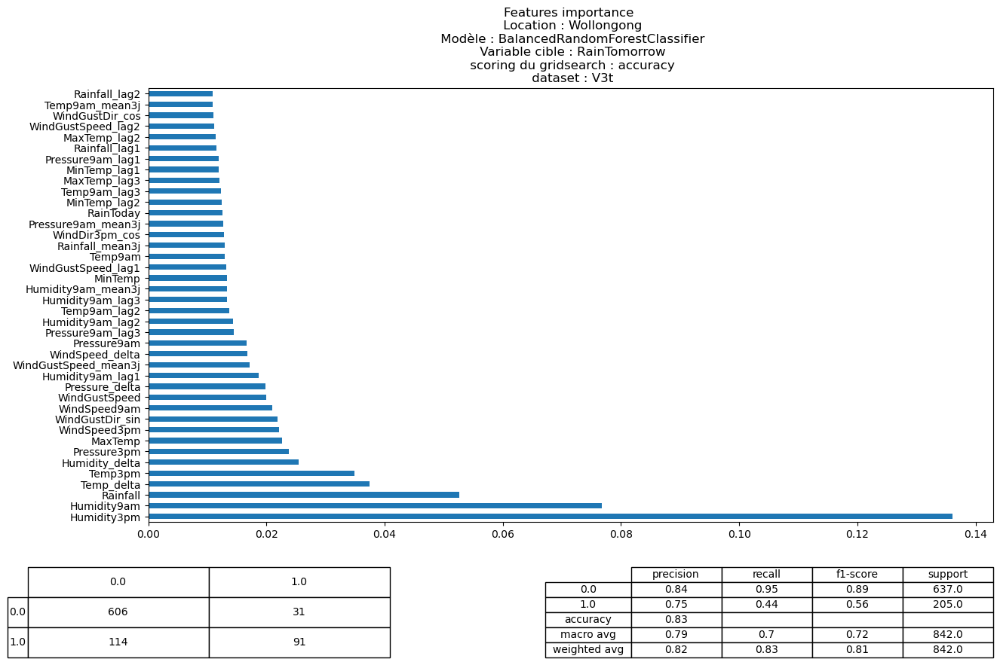

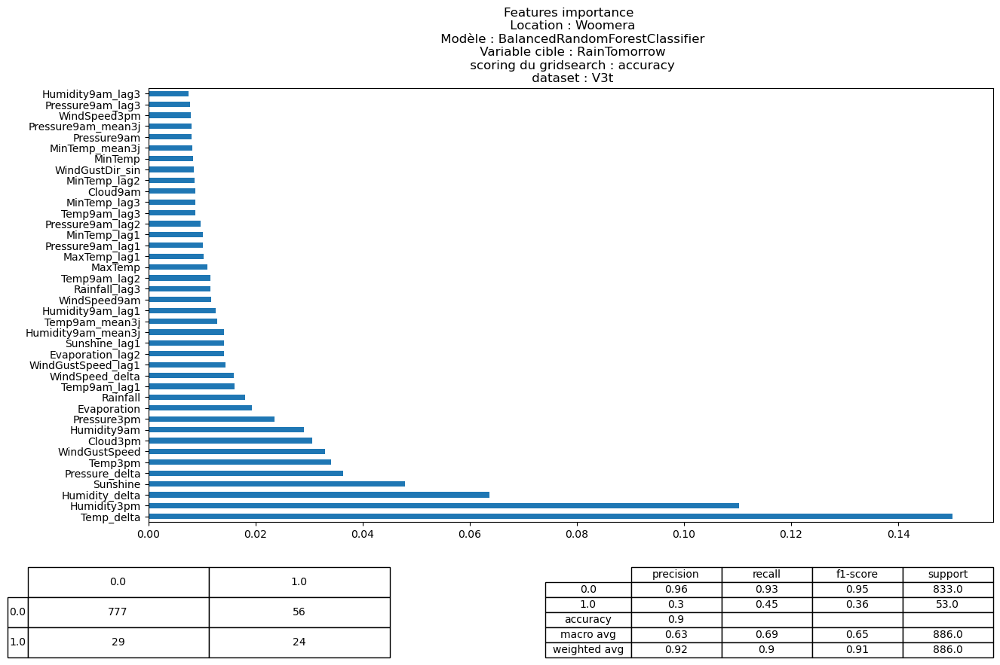

In [8]:
# Données V2 

df_V3 =  pd.read_csv("../data_saved/data_preprocessed_V2.csv", index_col=["id_Location","id_Date"])
location_list = np.unique(df_V3.index.get_level_values(0).values)
#location_list = ["Canberra","Sydney"]
# préfixe de sauvegarde des modèles 
modeling_batch = "largegrid_"
modeling_batch = "simplegrid"

# scoring du grid search
scoring = "accuracy"
dataset = "V3t"
model_name = "RandomForestClassifier"
model_qual = "best"
variable_cible = "RainTomorrow"

for model_name in models_select.keys():

  for select_location in location_list:
      
      df_location =  pd.read_csv("../src/data_location_V3/df_" + select_location + ".csv", index_col=["id_Location","id_Date"])
      
      X_train, X_test, y_train, y_test = \
          mf.separation_train_test(df_location, 
                              sep_method = "temporelle", 
                              col_target = "RainTomorrow")
      X_train_scaled, X_test_scaled = mf.scaling(X_train, X_test, scaler = MinMaxScaler())
      
      
      model_dir =  "../saved_models/location/" + dataset + "/" + modeling_batch + "/" + \
      scoring + "_"+ select_location + "_" + model_qual + "_" + model_name

      graph_dir = "../modeling_results/location/" + dataset + "/" + modeling_batch + "/" + \
        scoring + "_"  + select_location + "_" + model_qual + "_" + model_name

      graph_title = "\n Location : " + select_location +\
          "\n Modèle : " + model_name +\
          "\n Variable cible : " + variable_cible + \
          "\n scoring du gridsearch : " + scoring + \
          "\n dataset : " + dataset 
      
      mf.plot_model_results(model_name, model_dir, graph_dir, 
                        graph_title,
                        X_train_scaled, X_test_scaled, y_train, y_test)

# Graph comparatif des modèles par location

In [5]:

#  liste des locations
df_V2 =  pd.read_csv("../data_saved/data_preprocessed_V2.csv", index_col=["id_Location","id_Date"])
location_list = np.unique(df_V2.index.get_level_values(0).values)
#location_list = ["Canberra","Sydney"]

# préfixe de sauvegarde des modèles 
modeling_batch = "largegrid_"

# scoring du grid search
scoring = "accuracy"

model_name = "RandomForestClassifier"
model_qual = "best"
variable_cible = "RainTomorrow"

metrics_list = ['precision', 'recall',  'f1-score']
class_label = '1.0'

model_list = models_select.keys()

table_results_V2 = mf.compare_model_results(
    "simplegrid", model_qual, model_list, 
    location_list,metrics_list,class_label, scoring, dataset = "V2t")

# table_results_V2_large = mf.compare_model_results(
#     "largegrid_", model_qual, model_list, 
#     location_list,metrics_list,class_label, scoring, dataset = "V2t")
      

table_results_V3 = mf.compare_model_results(
    "simplegrid", model_qual, model_list, 
    location_list,metrics_list,class_label, scoring, dataset = "V2t")

      

Part des données par années  Date
2008   0.05
2009   0.17
2010   0.29
2011   0.39
2012   0.50
2013   0.60
2014   0.71
2015   0.83
2016   0.94
2017   1.00
Name: count, dtype: float64
Séparation des données avant et après  2015
Fitting  LogisticRegression


Nom du modèle : LogisticRegression
Rapport de classification :
              precision  recall  f1-score  support
0.0                0.86    0.98      0.92   708.00
1.0                0.88    0.41      0.56   191.00
accuracy           0.86    0.86      0.86     0.86
macro avg          0.87    0.70      0.74   899.00
weighted avg       0.87    0.86      0.84   899.00
Matrice de confusion :
      0.00  1.00
0.00   697    11
1.00   112    79
Part des données par années  Date
2008   0.01
2009   0.15
2010   0.29
2011   0.42
2012   0.55
2013   0.68
2014   0.82
2015   0.92
2016   0.98
2017   1.00
Name: count, dtype: float64
Séparation des données avant et après  2014
Fitting  LogisticRegression


Nom du modèle : LogisticRegression
Rapport de

In [8]:
print(table_results_V2)
#print(table_results_V2_large)
print(table_results_V3)

                                   precision recall f1-score accuracy
Location    model_name                                               
Adelaide    RandomForestClassifier      0.79   0.52     0.63     0.87
            LogisticRegression          0.85   0.46     0.60     0.87
Albany      RandomForestClassifier      0.84   0.48     0.61     0.73
            LogisticRegression          0.74   0.22     0.34     0.62
Albury      RandomForestClassifier      0.76   0.44     0.56     0.86
...                                      ...    ...      ...      ...
Witchcliffe LogisticRegression          0.78   0.69     0.73     0.85
Wollongong  RandomForestClassifier      0.86   0.34     0.49     0.83
            LogisticRegression          0.77   0.44     0.56     0.83
Woomera     RandomForestClassifier      0.70   0.25     0.37     0.95
            LogisticRegression          0.64   0.38     0.48     0.95

[98 rows x 4 columns]
                                   precision recall f1-score accura

In [7]:

table_results = table_results_V2
table_results["Location"] = table_results.index.get_level_values(0).values
table_results["model_name"] = table_results.index.get_level_values(1).values


table_results[metrics_list] = table_results.loc[:,metrics_list].astype(float)
table_results["accuracy"] = table_results.loc[:,"accuracy"].astype(float)


table_results.to_csv("../t.csv")
table_results = pd.read_csv("../t.csv")
display(table_results)
# sns.barplot(data=table_results2, 
#             x = "Location", y = "accuracy", col="model_name", kind="bar")

# sns.catplot(data=table_results, 
#              x = "Location", y = "accuracy", row = "model_name", kind="bar")
# plt.xticks(rotation = 90)
# plt.show()

# sns.catplot(data=table_results, 
#              x = "Location", y = "precision", row = "model_name", kind="bar")
# plt.xticks(rotation = 90)
# plt.show()

# sns.catplot(data=table_results, 
#              x = "Location", y = "precision", row = "model_name", kind="bar")
# plt.xticks(rotation = 90)
# plt.show()



,Unnamed: 0,Unnamed: 1,precision,recall,f1-score,accuracy,Location,model_name
0,Location,model_name,NaN,NaN,NaN,NaN,NaN,NaN
1,Adelaide,LogisticRegression,0.88,0.41,0.56,0.86,Adelaide,LogisticRegression
2,Adelaide,RandomForestClassifier,0.85,0.45,0.59,0.87,Adelaide,RandomForestClassifier
3,Adelaide,BalancedRandomForestClassifier,0.76,0.53,0.62,0.86,Adelaide,BalancedRandomForestClassifier
4,Albany,LogisticRegression,0.76,0.17,0.28,0.61,Albany,LogisticRegression
...,...,...,...,...,...,...,...,...
143,Wollongong,RandomForestClassifier,0.80,0.37,0.50,0.82,Wollongong,RandomForestClassifier
144,Wollongong,BalancedRandomForestClassifier,0.69,0.57,0.63,0.83,Wollongong,BalancedRandomForestClassifier
145,Woomera,LogisticRegression,0.75,0.38,0.51,0.95,Woomera,LogisticRegression
146,Woomera,RandomForestClassifier,0.62,0.24,0.34,0.94,Woomera,RandomForestClassifier


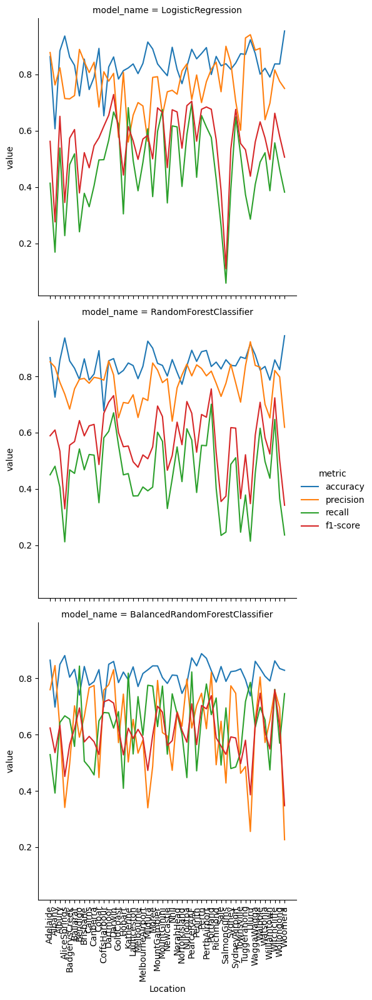

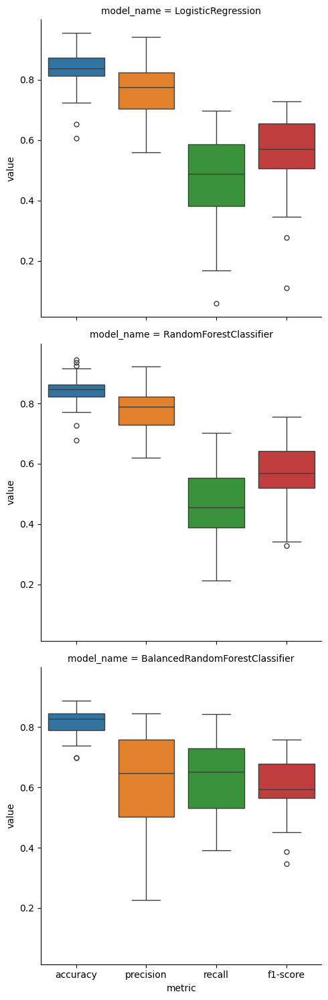

In [8]:
table_results = table_results_V2
table_results["Location"] = table_results.index.get_level_values(0).values
table_results["model_name"] = table_results.index.get_level_values(1).values


table_results[metrics_list] = table_results.loc[:,metrics_list].astype(float)
table_results["accuracy"] = table_results.loc[:,"accuracy"].astype(float)


table_results.to_csv("../t.csv")
table_results = pd.read_csv("../t.csv")
table_results2 = pd.melt(table_results, id_vars= ["Location","model_name"], 
               value_vars = ["accuracy","precision","recall","f1-score"], 
               var_name='metric')

sns.relplot(data=table_results2 , 
             x = "Location", y = "value", hue="metric", 
             row = "model_name", kind="line")
plt.xticks(rotation = 90)

sns.catplot(data=table_results2 , 
             x = "metric", y = "value", hue="metric", 
             row = "model_name", kind="box")

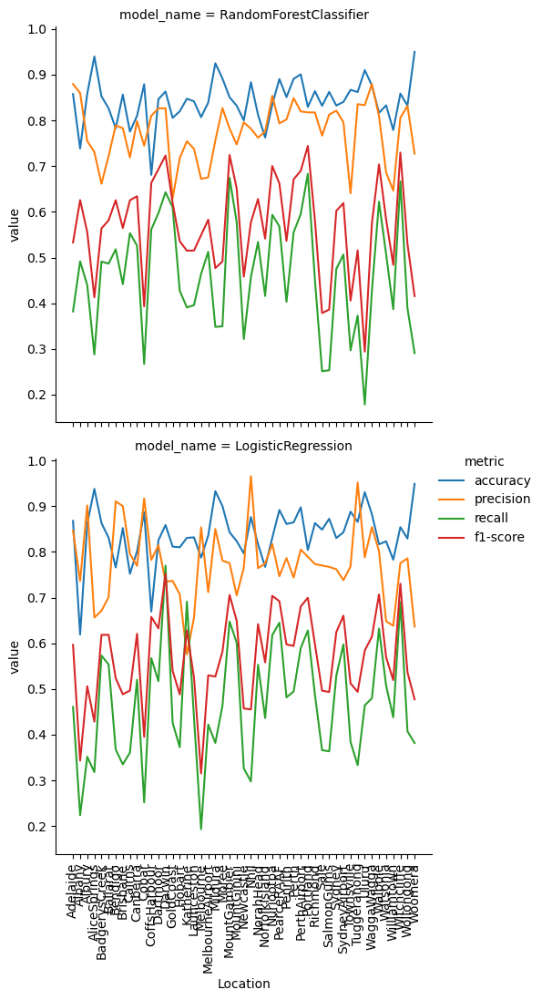

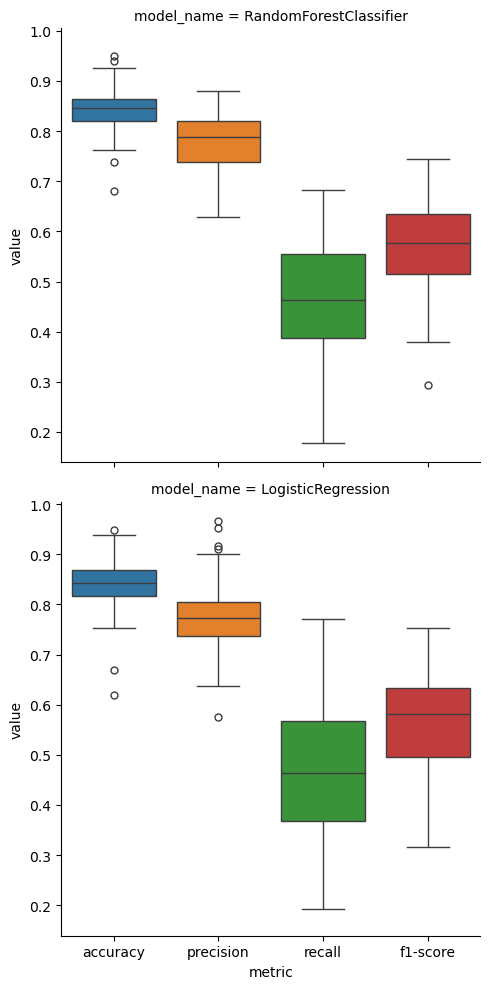

In [18]:
table_results = table_results_V3
table_results["Location"] = table_results.index.get_level_values(0).values
table_results["model_name"] = table_results.index.get_level_values(1).values


table_results[metrics_list] = table_results.loc[:,metrics_list].astype(float)
table_results["accuracy"] = table_results.loc[:,"accuracy"].astype(float)


table_results.to_csv("../t.csv")
table_results = pd.read_csv("../t.csv")

table_results2 = pd.melt(table_results, id_vars= ["Location","model_name"], 
               value_vars = ["accuracy","precision","recall","f1-score"], 
               var_name='metric')

sns.relplot(data=table_results2, 
             x = "Location", y = "value", hue="metric", 
             row = "model_name", kind="line")
plt.xticks(rotation = 90)

sns.catplot(data=table_results2, 
             x = "metric", y = "value", hue="metric", 
             row = "model_name", kind="box")

# Seuil de classification


In [15]:

# model par location
select_location = "Brisbane"

# Choix des modèles (fixe pour l'instant) 
models_select  = {
    'LogisticRegression': LogisticRegression(max_iter = 500, n_jobs=-1),
    'RandomForestClassifier': RandomForestClassifier(n_jobs=-1),
    'BalancedRandomForestClassifier': BalancedRandomForestClassifier(n_jobs=-1)
}

df_location =  pd.read_csv("../src/data_location_V2/df_" + select_location + ".csv", index_col=["id_Location","id_Date"])
X_train, X_test, y_train, y_test = \
        mf.separation_train_test(df_location, 
                            sep_method = "temporelle", 
                            col_target = "RainTomorrow")


X_train_scaled, X_test_scaled = mf.scaling(X_train, X_test, scaler = MinMaxScaler())


modeling_batch = "simplegrid"
scoring = "f1_score"
dataset = "V2t"
model_name = "LogisticRegression"
model_qual = "best"
variable_cible = "RainTomorrow"

model_dir =  "../saved_models/location/" + dataset + "/" + modeling_batch + "/" + \
    scoring + "_"+ select_location + "_" + model_qual + "_" + model_name

graph_dir = "../modeling_results/location/" + dataset + "/" + modeling_batch + "/" + \
    scoring + "_" + select_location + "_" + model_qual + "_" + model_name

graph_title = "\n Location : " + select_location +\
        "\n Modèle : " + model_name +\
        "\n scoring du gridsearch : " + scoring
        
# charge le modèle 
with open(model_dir + ".pkl", 'rb') as f:
   model = pickle.load(f)

print(model)

Part des données par années  Date
2008   0.06
2009   0.17
2010   0.29
2011   0.39
2012   0.50
2013   0.60
2014   0.72
2015   0.83
2016   0.95
2017   1.00
Name: count, dtype: float64
Séparation des données avant et après  2015
LogisticRegression(C=10, class_weight={0: 0.5, 1: 0.5}, max_iter=500, n_jobs=-1,
                   solver='liblinear')


Best Threshold=0.000379, F-Score=0.000
Seuil :  0.2485545653018385
Avant ajustement : 
score accuracy :  0.8542600896860987
f1 score :  0.6036585365853658
roc-auc score :  0.7341785541586073
[[663  41]
 [ 89  99]] 


              precision    recall  f1-score   support

         0.0       0.88      0.94      0.91       704
         1.0       0.71      0.53      0.60       188

    accuracy                           0.85       892
   macro avg       0.79      0.73      0.76       892
weighted avg       0.84      0.85      0.85       892

0.7071428571428572
0.526595744680851
après ajustement : 
score accuracy :  0.8542600896860987
f1 score :  0.6651270207852193
roc-auc score :  0.8112457688588008
[[603 101]
 [ 44 144]] 


              precision    recall  f1-score   support

         0.0       0.93      0.86      0.89       704
         1.0       0.59      0.77      0.67       188

    accuracy                           0.84       892
   macro avg       0.76      0.81      0.78       8

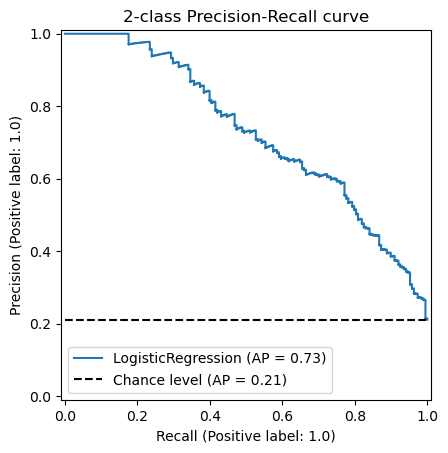

In [16]:
from sklearn.metrics import precision_recall_curve, roc_curve, roc_auc_score


model.fit(X_train, y_train)
y_pred = model.predict(X_test)
preds = model.predict_proba(X_test)

# calculate pr curve
precision, recall, thresholds = precision_recall_curve(y_test, preds[:,1], pos_label='1')

# convert to f score
fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
print('Best Threshold=%f, F-Score=%.3f' % (thresholds[ix], fscore[ix]))


from sklearn.metrics import PrecisionRecallDisplay

display = PrecisionRecallDisplay.from_estimator(
   model, X_test, y_test, name=model_name, plot_chance_level=True)
_ = display.ax_.set_title("2-class Precision-Recall curve")


fpr, tpr, thresholds = roc_curve( y_test, preds[:,1])
roc_auc = roc_auc_score(y_test, preds[:,1])

optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]

y_pred2 = (preds[:,1] > optimal_threshold).astype(int)

print("Seuil : ", optimal_threshold)

print("Avant ajustement : ")
print('score accuracy : ', model.score(X_test, y_test))
print('f1 score : ', f1_score(y_test, y_pred))
print('roc-auc score : ', roc_auc_score(y_test, y_pred))
print(confusion_matrix(y_test, y_pred), '\n\n')
print(classification_report(y_test, y_pred))
print(precision_score(y_test, y_pred))
print(recall_score(y_test, y_pred))

print("après ajustement : ")
print('score accuracy : ', model.score(X_test, y_test))
print('f1 score : ', f1_score(y_test, y_pred2))
print('roc-auc score : ', roc_auc_score(y_test, y_pred2))
print(confusion_matrix(y_test, y_pred2), '\n\n')
print(classification_report(y_test, y_pred2))
print(precision_score(y_test, y_pred2))
print(recall_score(y_test, y_pred2))